In [1]:
import pandas as pd
import plotly.express as px

from sklearn.model_selection import train_test_split

from soccer_analytics.data.statsbomb import get_metadata, get_events, load_competition_seasons
from soccer_analytics.data_split import split_by_time
from soccer_analytics.preprocessing import match_list_to_df, AngleNormalizer

In [2]:
competitions = get_metadata()

In [3]:
full_competitions = {
    "1. Bundesliga": ["2015/2016"],
    "FA Women's Super League": ["2018/2019", "2019/2020", "2020/2021"],
    "FIFA World Cup": ["2022", "2018", "2022"],
    "Indian Super league": ["2021/2022"],
    "La Liga": ["2015/2016"],
    "Ligue 1": ["2015/2016"],
    "Premier League": ["2015/2016"],
    "Serie A": ["2015/2016"],
    "UEFA Euro": ["2020"],
    "UEFA Women's Euro": ["2022"],
    "Women's World Cup": ["2019", "2023"]
}

In [4]:
matches_by_competition = {}
for competition_name, seasons in full_competitions.items():
    print(competition_name, len(seasons))
    matches_by_competition[competition_name] = load_competition_seasons(
        competition_name, seasons, event_types=["shot"]
    )

1. Bundesliga 1
FA Women's Super League 3
FIFA World Cup 3
Indian Super league 1
La Liga 1
Ligue 1 1
Premier League 1
Serie A 1
UEFA Euro 1
UEFA Women's Euro 1
Women's World Cup 2


In [5]:
all_train_data = []
for competition_name, matches in matches_by_competition.items():
    train_test_matches, _ = split_by_time(matches, test_frac=0.2)
    train_matches, test_matches = train_test_split(
        train_test_matches, test_size=0.2, random_state=235
    )
    all_train_data.append(match_list_to_df(train_matches))
all_train_data = pd.concat(all_train_data)
angle_normalizer = AngleNormalizer(variable="angle_to_goal", new_variable="angle_from_goal")
all_train_data = angle_normalizer.fit_transform(all_train_data)
field_shot_data = all_train_data[all_train_data.is_penalty == False]

In [6]:
all_train_data.shape

(41846, 26)

In [7]:
all_train_data.head()

,is_penalty,is_first_time,statsbomb_xg,technique,coordinates_x,coordinates_y,distance_to_goal,is_body_part_right_foot,is_body_part_left_foot,is_body_part_head,...,is_body_part_other,is_body_part_no_touch,position,situation,closest_defender_distance,is_goal,is_blocked,timestamp,freeze_frame,angle_from_goal
0,False,False,0.060972,Normal,96.95,34.75,23.640326,False,True,False,...,False,False,Center Attacking Midfield,Open Play,2.706474,0,0,229.997,"[{'location': [102.6, 34.9], 'player': {'id': ...",12.831123
1,False,True,0.009246,Half Volley,103.65,60.15,25.948892,True,False,False,...,False,False,Right Wing,Open Play,6.285300,0,0,261.118,"[{'location': [118.1, 43.8], 'player': {'id': ...",50.943628
2,False,False,0.174419,Normal,107.55,53.15,18.108700,True,False,False,...,False,False,Right Wing,Open Play,3.975550,0,0,381.282,"[{'location': [98.0, 39.7], 'player': {'id': 2...",46.566291
3,False,False,0.005534,Normal,95.25,60.35,32.041926,False,True,False,...,False,False,Right Defensive Midfield,Open Play,1.710263,0,1,603.564,"[{'location': [97.6, 65.5], 'player': {'id': 8...",39.427802
4,False,False,0.089776,Normal,115.55,30.95,10.084890,False,False,True,...,False,False,Left Center Back,Open Play,0.514782,0,0,867.754,"[{'location': [119.0, 37.4], 'player': {'id': ...",63.816068


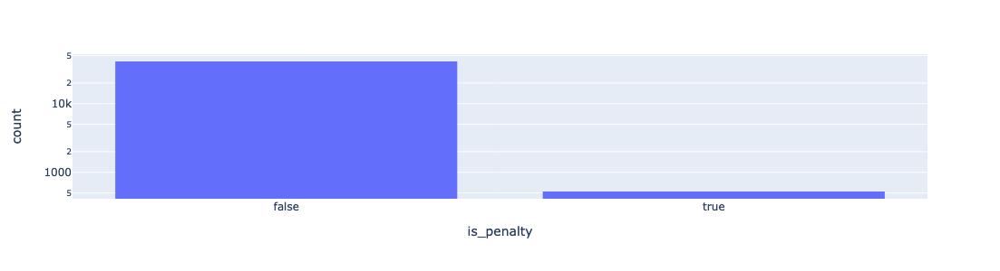

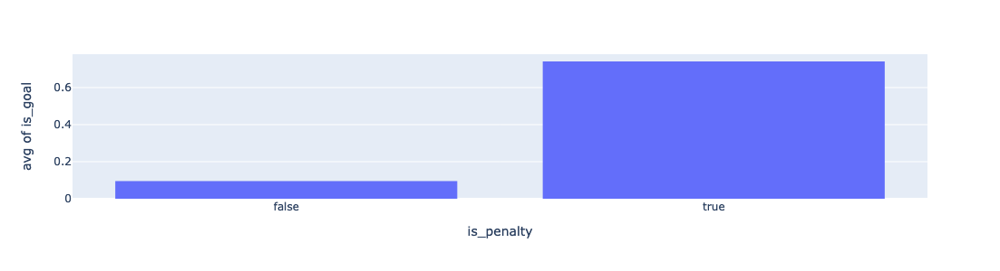

In [8]:
column = "is_penalty"
fig = px.histogram(all_train_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(all_train_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

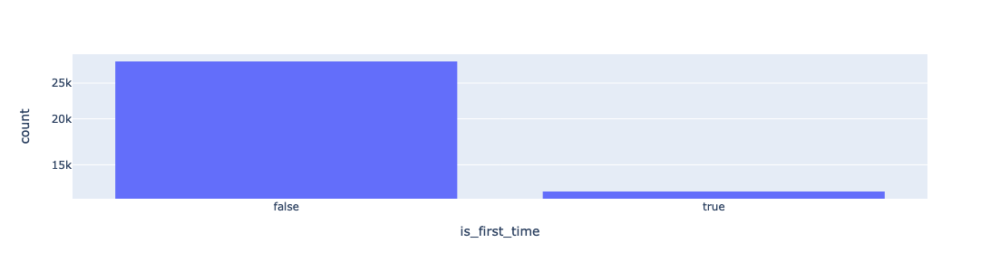

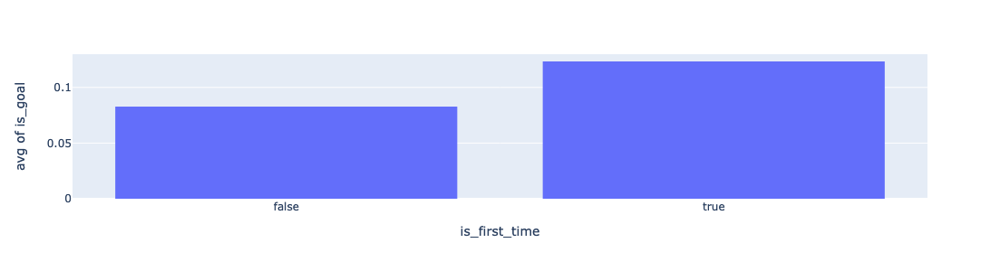

In [9]:
column = "is_first_time"
fig = px.histogram(field_shot_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

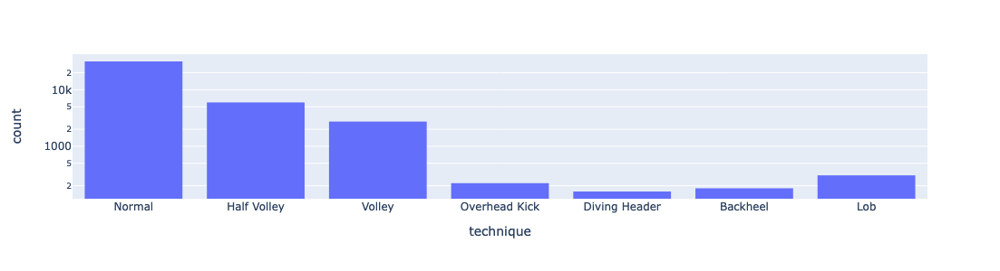

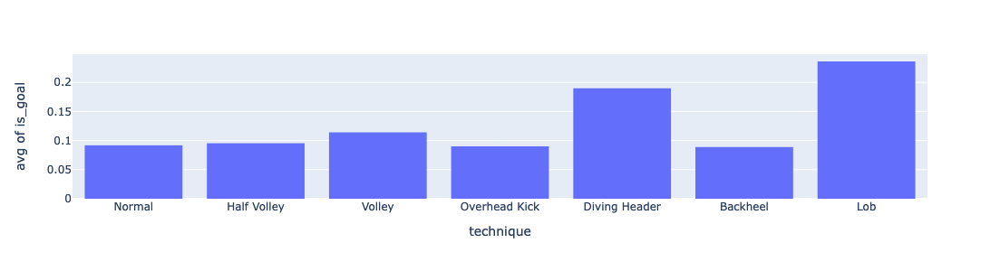

In [10]:
column = "technique"
fig = px.histogram(field_shot_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

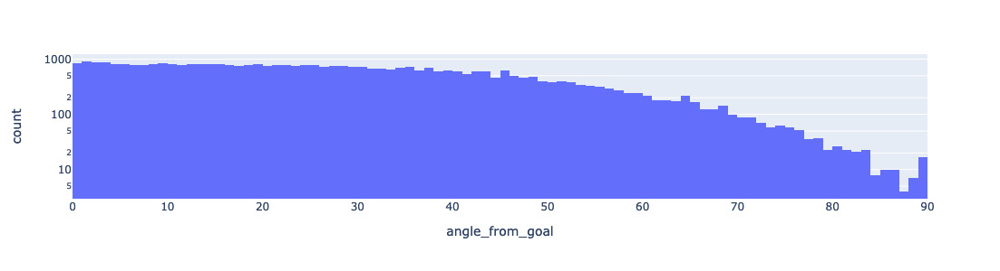

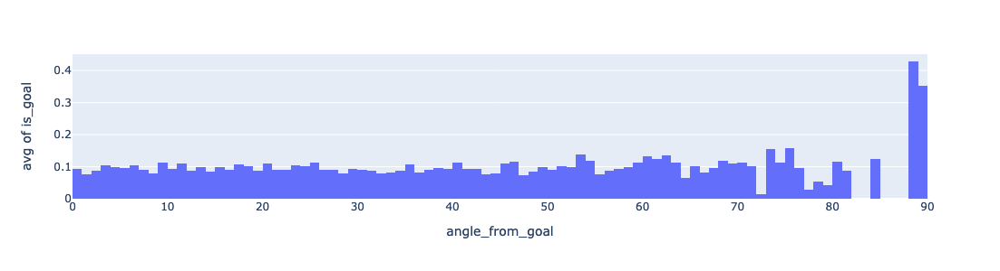

In [11]:
column = "angle_from_goal"
fig = px.histogram(field_shot_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

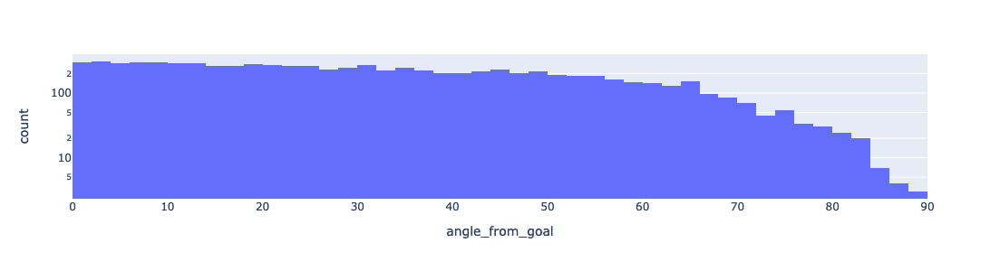

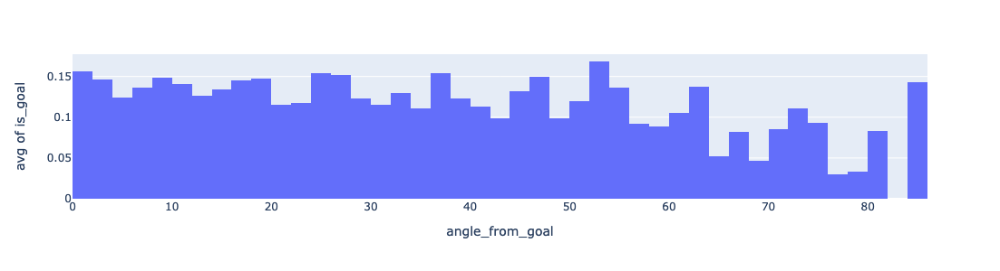

In [26]:
column = "angle_from_goal"
fig = px.histogram(field_shot_data[field_shot_data.distance_to_goal.between(10, 15)], x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data[field_shot_data.distance_to_goal.between(10, 15)], x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

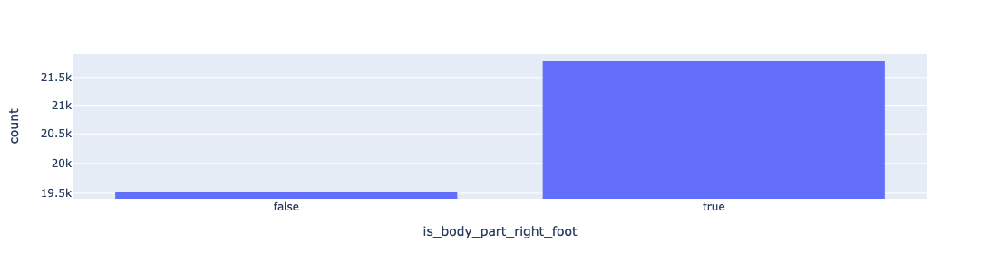

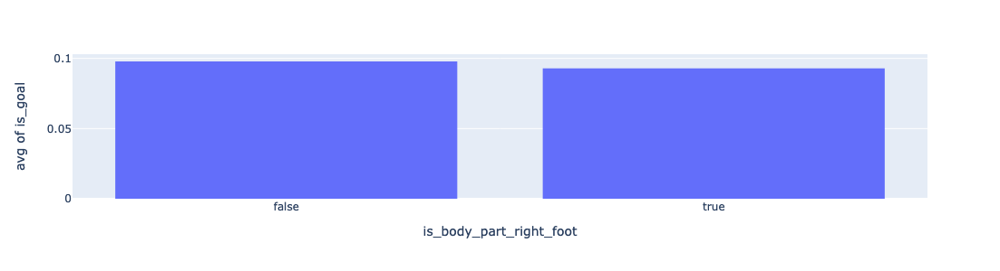

In [12]:
column = "is_body_part_right_foot"
fig = px.histogram(field_shot_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

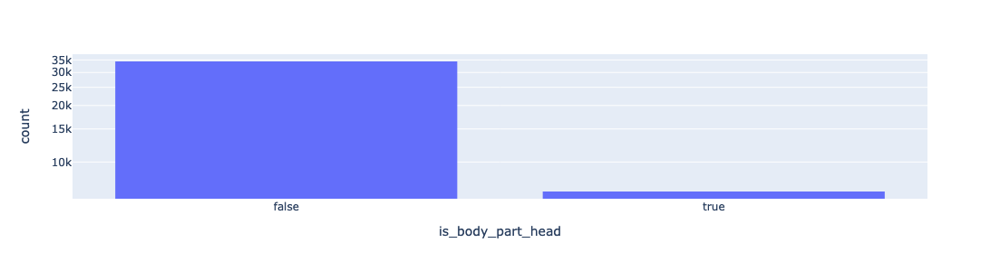

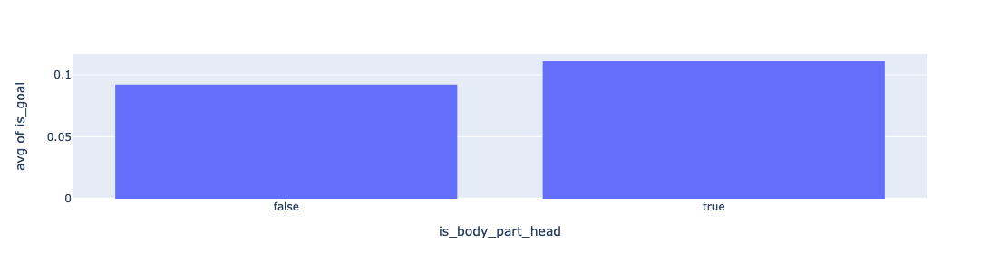

In [13]:
column = "is_body_part_head"
fig = px.histogram(field_shot_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

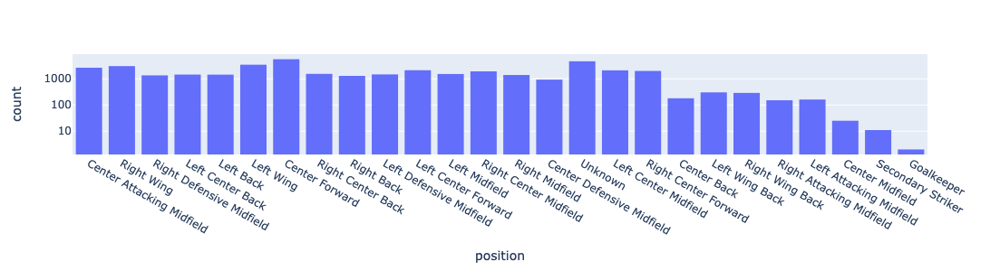

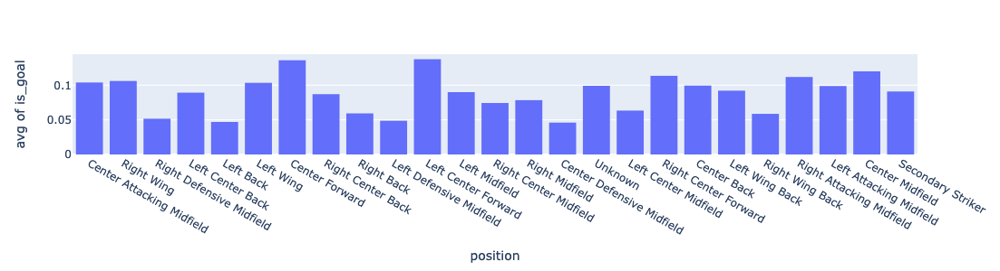

In [14]:
column = "position"
fig = px.histogram(field_shot_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

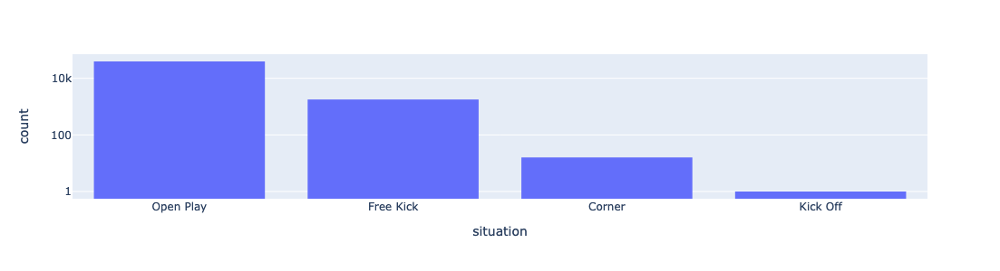

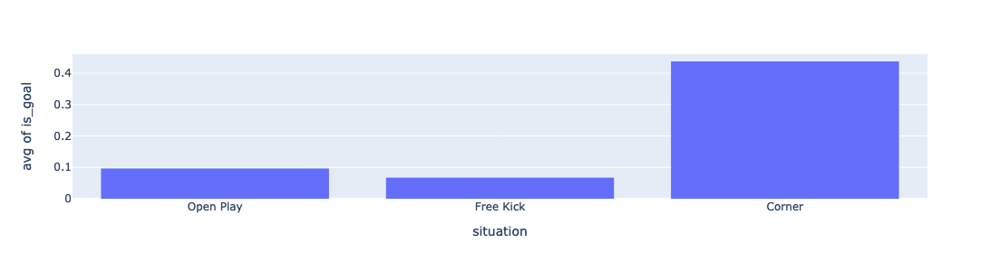

In [15]:
column = "situation"
fig = px.histogram(field_shot_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

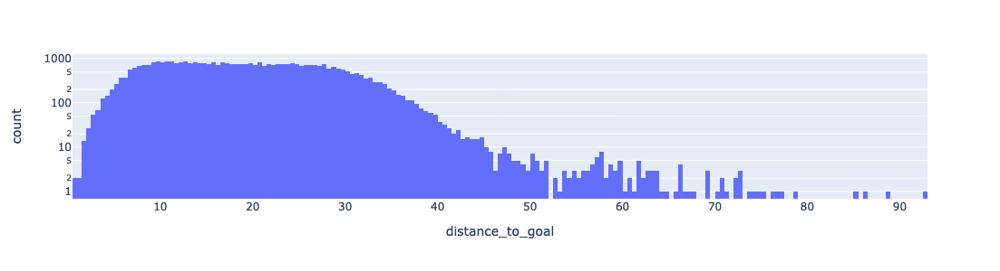

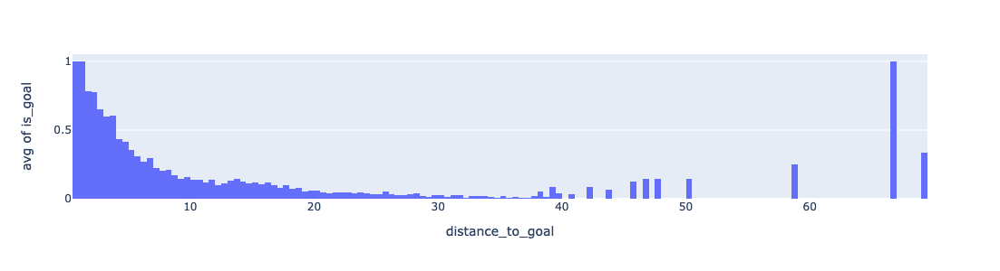

In [16]:
column = "distance_to_goal"
fig = px.histogram(field_shot_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

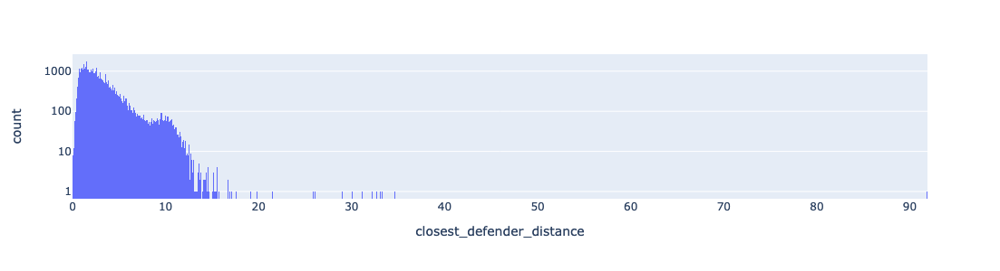

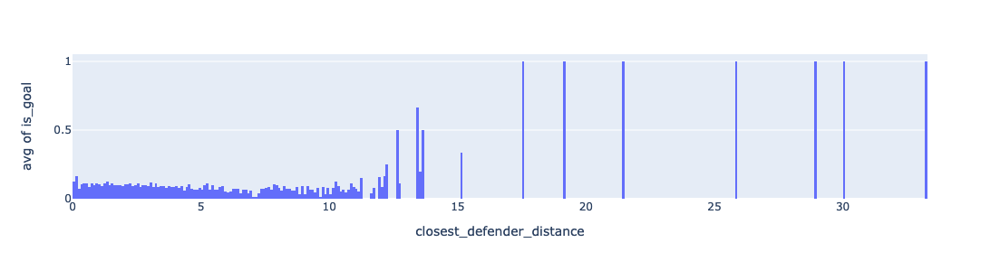

In [17]:
column = "closest_defender_distance"
fig = px.histogram(field_shot_data, x=column, log_y=True)
fig.update_layout(
    autosize=False,
    width=900,
    height=300,
)
fig.show()
px.histogram(field_shot_data, x=column, y="is_goal", histfunc="avg").update_layout(
    autosize=False,
    width=900,
    height=300,
)

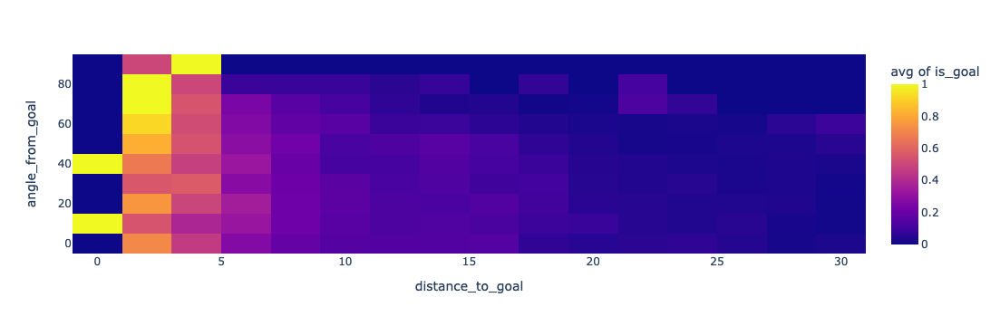

In [21]:
px.density_heatmap(
    field_shot_data[field_shot_data.distance_to_goal < 30],
    x="distance_to_goal",
    y="angle_from_goal",
    z="is_goal",
    nbinsx=20,
    nbinsy=10,
    histfunc="avg"
)

In [22]:
px.density_heatmap?

Signature:
px.density_heatmap(
    data_frame=None,
    x=None,
    y=None,
    z=None,
    facet_row=None,
    facet_col=None,
    facet_col_wrap=0,
    facet_row_spacing=None,
    facet_col_spacing=None,
    hover_name=None,
    hover_data=None,
    animation_frame=None,
    animation_group=None,
    category_orders=None,
    labels=None,
    orientation=None,
    color_continuous_scale=None,
    range_color=None,
    color_continuous_midpoint=None,
    marginal_x=None,
    marginal_y=None,
    opacity=None,
    log_x=False,
    log_y=False,
    range_x=None,
    range_y=None,
    histfunc=None,
    histnorm=None,
    nbinsx=None,
    nbinsy=None,
    text_auto=False,
    title=None,
    template=None,
    width=None,
    height=None,
) -> plotly.graph_objs._figure.Figure
Docstring:
    In a density heatmap, rows of `data_frame` are grouped together into
    colored rectangular tiles to visualize the 2D distribution of an
    aggregate function `histfunc` (e.g. the count or sum) of t